# Création d'un dataset d'ordre de lecture sur PubLayNet

In [1]:
# !pip install Unidecode
# !pip install fuzzysearch

# !pip install elementpath
# !pip install lxml 
# !pip install graphviz
# !pip install pydotplus

In [3]:
!ls ../../../edspdf-train/data/publaynet/

dev.json			test	       train	       xmls
oa_file_list.ARTgjjvC.csv.part	test_urls.txt  train_urls.txt  xmls-bis


In [4]:
import sys
sys.path.append('../')
import os
from pathlib import Path
import json
from sort_xml import *
import numpy as np
import pickle as pk

from edspdf import Pipeline
from edspdf.structures import Box, PDFDoc


base_dir = '../../../edspdf-train/data/publaynet/'

%load_ext autoreload
%autoreload 2

sys.executable

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


'/export/home/smbaye/edspdf-train/.venv/bin/python'

### Load pdf and xml names and info

In [5]:
xmls_dir = base_dir + 'train/'
dev_path = base_dir + 'dev.json'

with open(Path(dev_path)) as f:
    samples = json.load(f)

# load xml files
xmls_names = {} # {pmc = {xml_fname, pdf_fname}}
for root, directories, files in os.walk(xmls_dir):
    for pmc in directories:
        fdir = xmls_dir + pmc
        for root2, directories2, files2 in os.walk(fdir):
            xml_fname = None
            pdfs_fnames = []
            for file in files2:
                if file.split('.')[-1] == 'nxml':
                    xml_fname = file
                if file.split('.')[-1] == 'pdf':
                    pdfs_fnames.append(file)

            lenghts = [len(pf) for pf in pdfs_fnames]
            # if len(lenghts) == 0:
            #   print(f'fdir ==> {fdir}')

            i_min = np.argmin(lenghts)
            xmls_names[pmc] = {'xml' :xml_fname, 'pdf': pdfs_fnames[i_min], 'page_num': None}
    break
# end load xml files
    
    
for image in samples['images']:
    pmc = image['file_name'].split('_')[0]
    if pmc in xmls_names:
        page_num = int(image['file_name'].split('_')[1].split('.')[0])
        xmls_names[pmc]['page_num'] = page_num


ValueError: attempt to get argmin of an empty sequence

In [ ]:
print(f'Nb pmc {len(xmls_names)}')
for k,v in xmls_names.items():
    print(f'k: {k} -> v: {v}')
    break

In [7]:
# model
model = Pipeline()
model.add_pipe("pdfminer-extractor", config=dict(extract_style="true"), name="extractor")

In [5]:
import subprocess
import re

# Commande à exécuter
command = 'ls ../../../edspdf-train/data/publaynet/train'  # Cette commande liste les fichiers dans le répertoire courant (sur Unix/Linux/Mac)

# Exécution de la commande
process = subprocess.run(command, shell=True, capture_output=True, text=True, encoding='utf-8', errors='ignore')

# Récupération et affichage de la sortie
pmcs = process.stdout
pmcs = re.sub(r'\x1b\[.*?m', '', pmcs).splitlines()

print("Standard Output:")
n1, n2 = 0, 100
print(pmcs[n1:n2])
print(len(pmcs[n1:n2]))

Standard Output:
['PMC1087887', 'PMC1087888', 'PMC1241820', 'PMC1247186', 'PMC1247188', 'PMC1247189', 'PMC1247474', 'PMC1247478', 'PMC1247480', 'PMC1247485', 'PMC1247515', 'PMC1247517', 'PMC1247523', 'PMC1247562', 'PMC1247569', 'PMC1247570', 'PMC1247573', 'PMC1247606', 'PMC1247607', 'PMC1247608', 'PMC1247616', 'PMC1247620', 'PMC1247625', 'PMC1247658', 'PMC1247661', 'PMC1253655', 'PMC1253658', 'PMC1253666', 'PMC1253668', 'PMC1253669', 'PMC1253670', 'PMC1253701', 'PMC1253705', 'PMC1253707', 'PMC1253711', 'PMC1253713', 'PMC1253717', 'PMC1253748', 'PMC1253753', 'PMC1253755', 'PMC1253756', 'PMC1253757', 'PMC1253761', 'PMC1257598', 'PMC1257601', 'PMC1257602', 'PMC1257607', 'PMC1257610', 'PMC1257643', 'PMC1257644', 'PMC1257646', 'PMC1257651', 'PMC1277117', 'PMC1277123', 'PMC1277856', 'PMC1277862', 'PMC1277864', 'PMC1277865', 'PMC1277867', 'PMC1277869', 'PMC1278474', 'PMC1278475', 'PMC1278484', 'PMC1278485', 'PMC1278486', 'PMC1280340', 'PMC1280348', 'PMC1280401', 'PMC1280404', 'PMC1281265', 'P

In [9]:
# OK 1-56

# PMC1277864  -->  57/100
for it,pmc in enumerate(pmcs[n1:n2]):
    print(f'\n------------------------\n{pmc}  -->  {1+it}/{len(pmcs[n1:n2])}')
    pmc_dir = xmls_dir + pmc

    pmc_data, (doc,tree), (front_nodes, body_nodes, table_nodes) = match_pdf_xml_2_json(pmc_dir, model, v=True)

    # save pk
    pk_path = pmc_dir + '/' + 'pmc_data.pkl'
    with open(pk_path, 'wb') as file:
        pk.dump(pmc_data, file)


------------------------
PMC1087887  -->  1/100
table 0 nodes 43/43
table 1 nodes 13/13
table 2 nodes 9/9
body nodes 63/71
front nodes 5/8

------------------------
PMC1087888  -->  2/100
table 0 nodes 30/30
body nodes 28/30
front nodes 3/5

------------------------
PMC1241820  -->  3/100
table 0 nodes 11/11
table 1 nodes 45/45
body nodes 55/58
front nodes 3/5

------------------------
PMC1247186  -->  4/100
table 0 nodes 8/8
body nodes 40/40
front nodes 4/5

------------------------
PMC1247188  -->  5/100
table 0 nodes 34/38
table 1 nodes 32/34
table 2 nodes 31/31
table 3 nodes 48/48
table 4 nodes 15/15
table 5 nodes 18/18
table 6 nodes 11/13
table 7 nodes 43/43
body nodes 51/53
front nodes 3/5

------------------------
PMC1247189  -->  6/100
table 0 nodes 21/21
table 1 nodes 40/43
table 2 nodes 45/45
table 3 nodes 8/8
table 4 nodes 6/6
body nodes 87/87
front nodes 5/5

------------------------
PMC1247474  -->  7/100
table 0 nodes 6/7
table 1 nodes 5/5
table 2 nodes 14/15
table 3 nod

KeyboardInterrupt: 

In [11]:
# Ok 58-100
# PMC1277864  -->  57/100
for it,pmc in enumerate(pmcs[n1+57:n2]):
    print(f'\n------------------------\n{pmc}  -->  {1+it+57}/{len(pmcs[n1:n2])}')
    pmc_dir = xmls_dir + pmc

    pmc_data, (doc,tree), (front_nodes, body_nodes, table_nodes) = match_pdf_xml_2_json(pmc_dir, model, v=True)

    # save pk
    pk_path = pmc_dir + '/' + 'pmc_data.pkl'
    with open(pk_path, 'wb') as file:
        pk.dump(pmc_data, file)


------------------------
PMC1277865  -->  58/100
table 0 nodes 17/18
table 1 nodes 7/7
body nodes 35/37
front nodes 5/5

------------------------
PMC1277867  -->  59/100
table 0 nodes 2/3
table 1 nodes 21/21
table 2 nodes 22/22
table 3 nodes 22/22
table 4 nodes 21/21
table 5 nodes 16/38
body nodes 37/38
front nodes 4/5

------------------------
PMC1277869  -->  60/100
table 0 nodes 13/19
table 1 nodes 19/19
body nodes 31/31
front nodes 4/5

------------------------
PMC1278474  -->  61/100
table 0 nodes 23/23
table 1 nodes 24/25
table 2 nodes 12/12
table 3 nodes 11/12
body nodes 64/64
front nodes 4/5

------------------------
PMC1278475  -->  62/100
body nodes 69/69
front nodes 4/5

------------------------
PMC1278484  -->  63/100
table 0 nodes 32/32
table 1 nodes 15/15
table 2 nodes 33/33
body nodes 36/38
front nodes 4/5

------------------------
PMC1278485  -->  64/100
table 0 nodes 5/5
table 1 nodes 22/25
table 2 nodes 25/25
table 3 nodes 23/25
table 4 nodes 25/25
body nodes 47/47
f

In [ ]:
# PMC1277864  -->  57/100
l_it_pmc = [(56, 'PMC1277864')]
for it,pmc in l_it_pmc:
    print(f'\n------------------------\n{pmc}  -->  {1+it}/{len(pmcs[n1:n2])}')
    pmc_dir = xmls_dir + pmc

    pmc_data, (doc,tree), (front_nodes, body_nodes, table_nodes) = match_pdf_xml_2_json(pmc_dir, model, v=True)

    # save pk
    pk_path = pmc_dir + '/' + 'pmc_data.pkl'
    with open(pk_path, 'wb') as file:
        pk.dump(pmc_data, file)


------------------------
PMC1277864  -->  57/100
table 0 nodes 7/7


In [16]:
# PMC1277864  -->  57/100
pmc_dir

'../../../edspdf-train/data/publaynet/train/PMC1277864'

xml path: ../../../edspdf-train/data/publaynet/train/PMC1277864/ehp0113-000192.nxml
pdf path: ../../../edspdf-train/data/publaynet/train/PMC1277864/ehp0113-000192.pdf


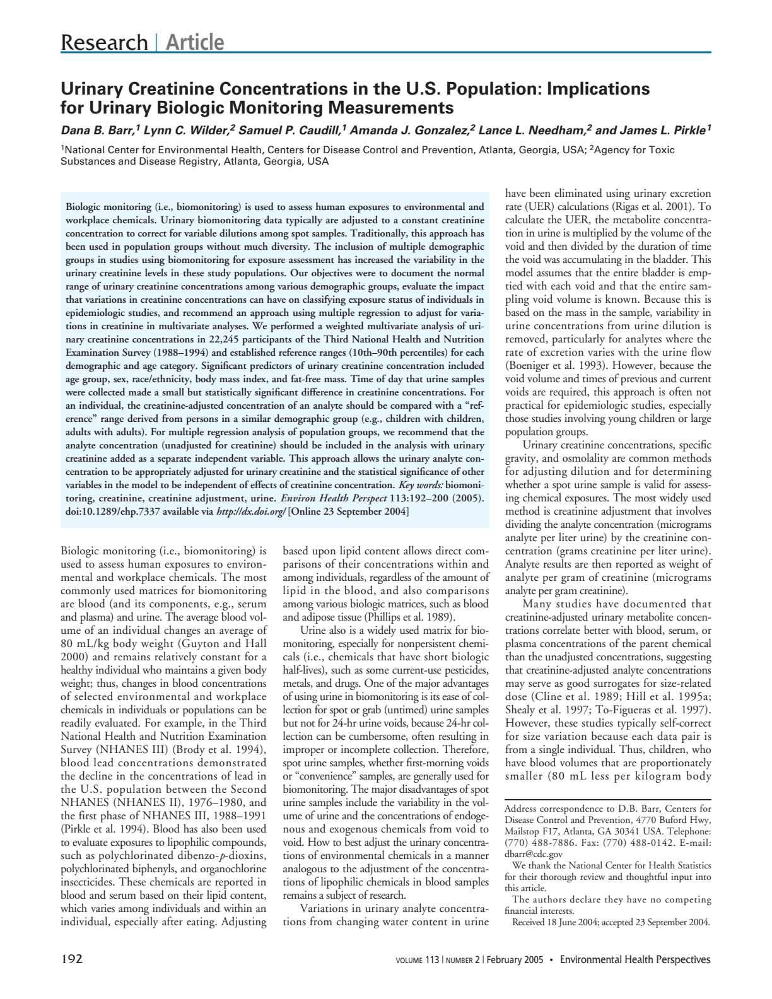

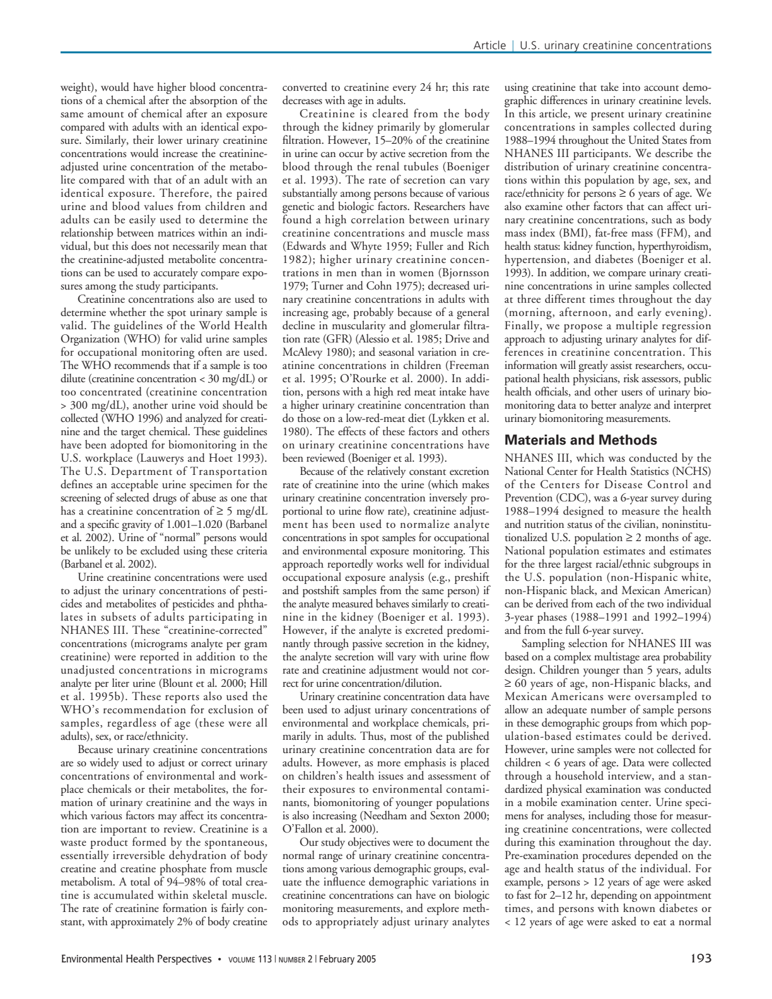

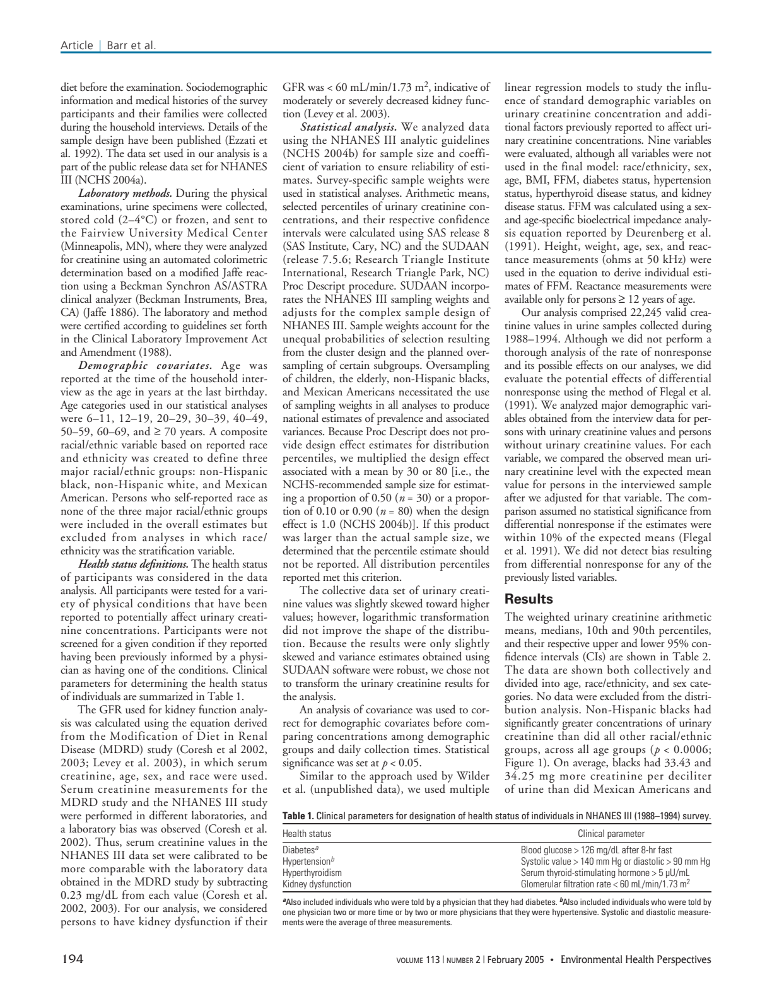

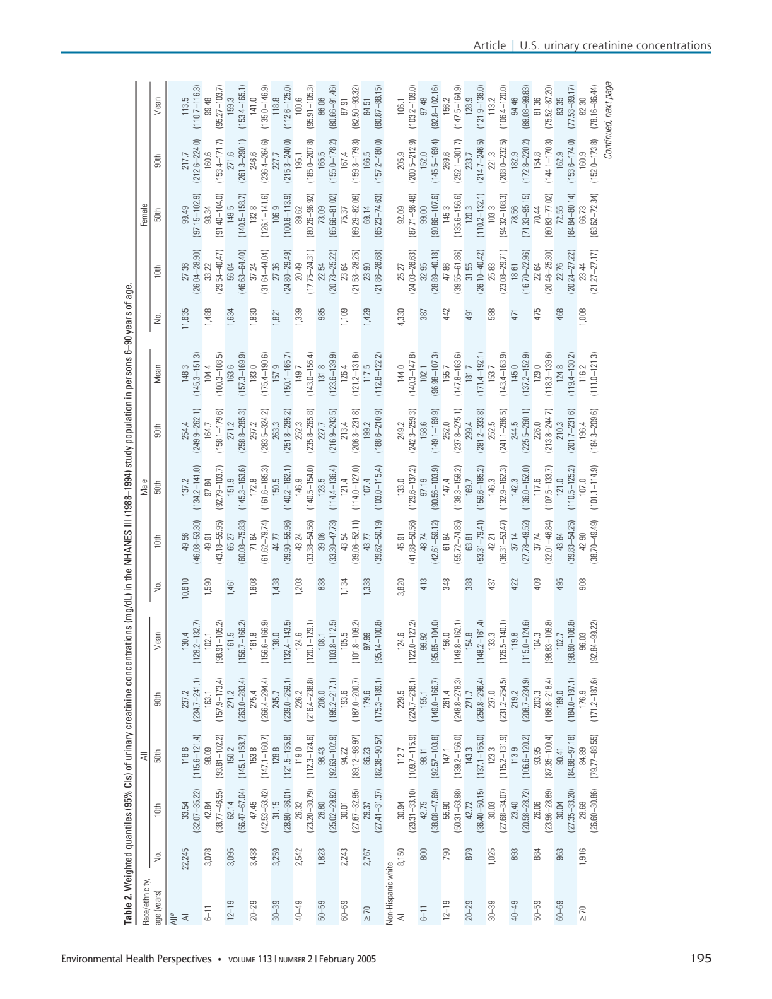

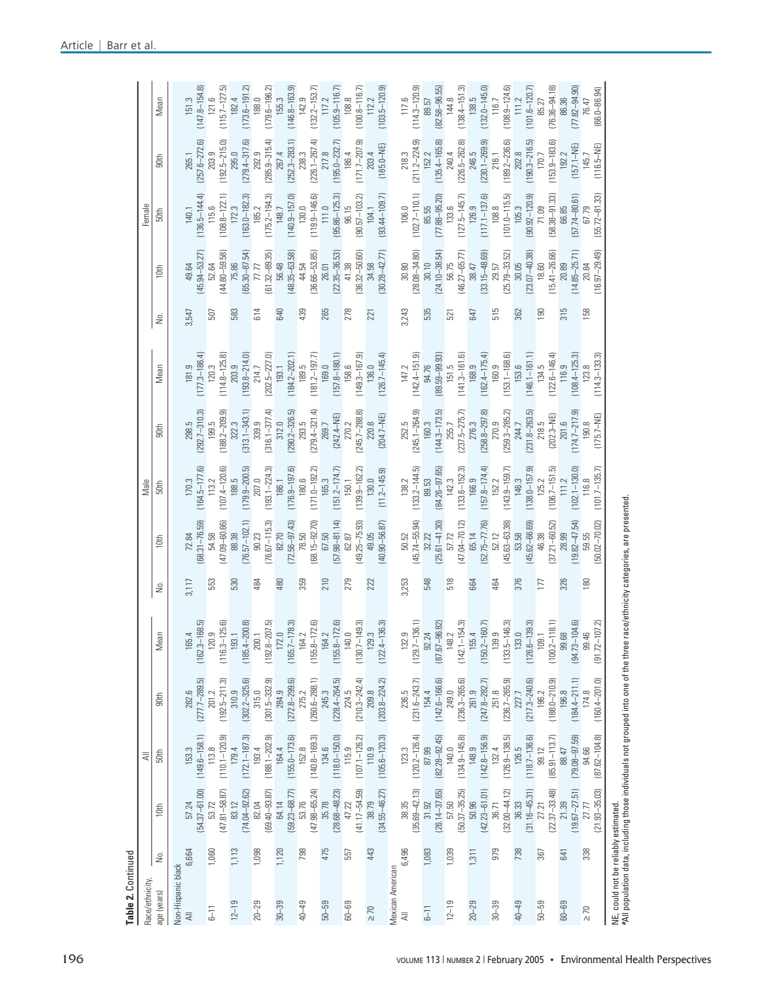

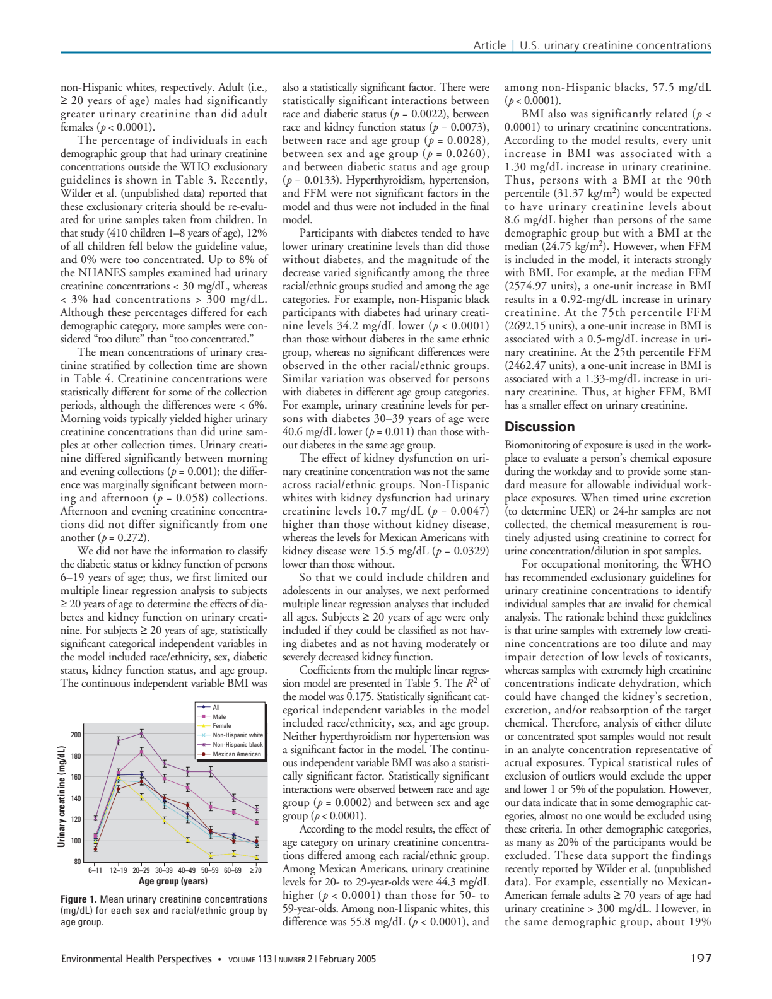

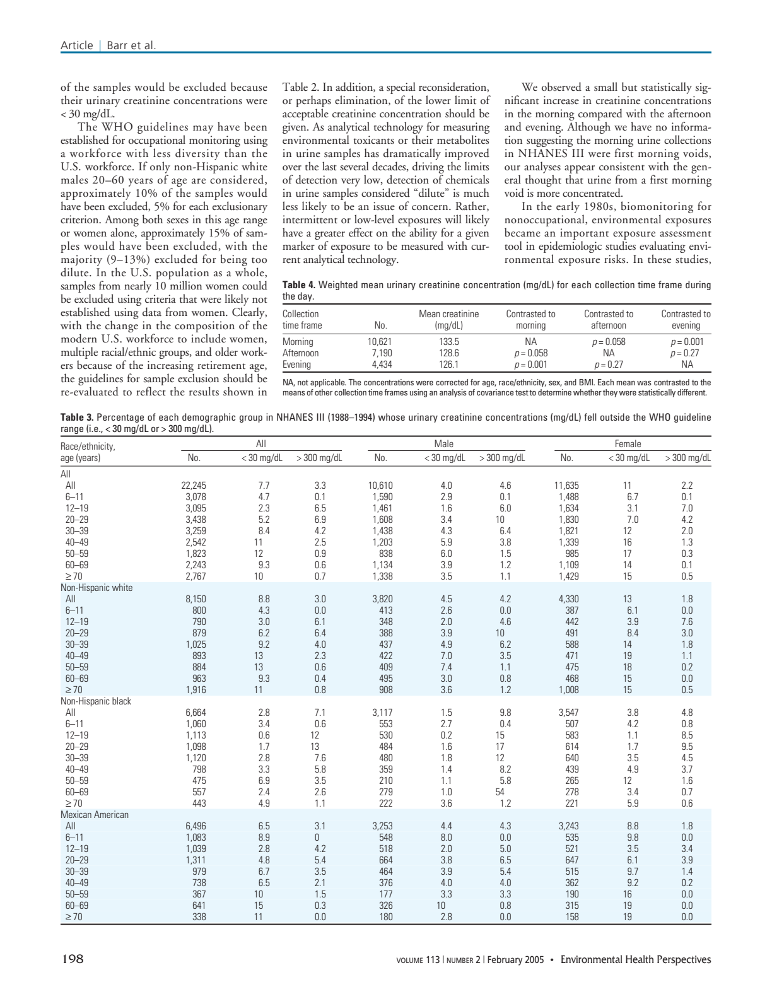

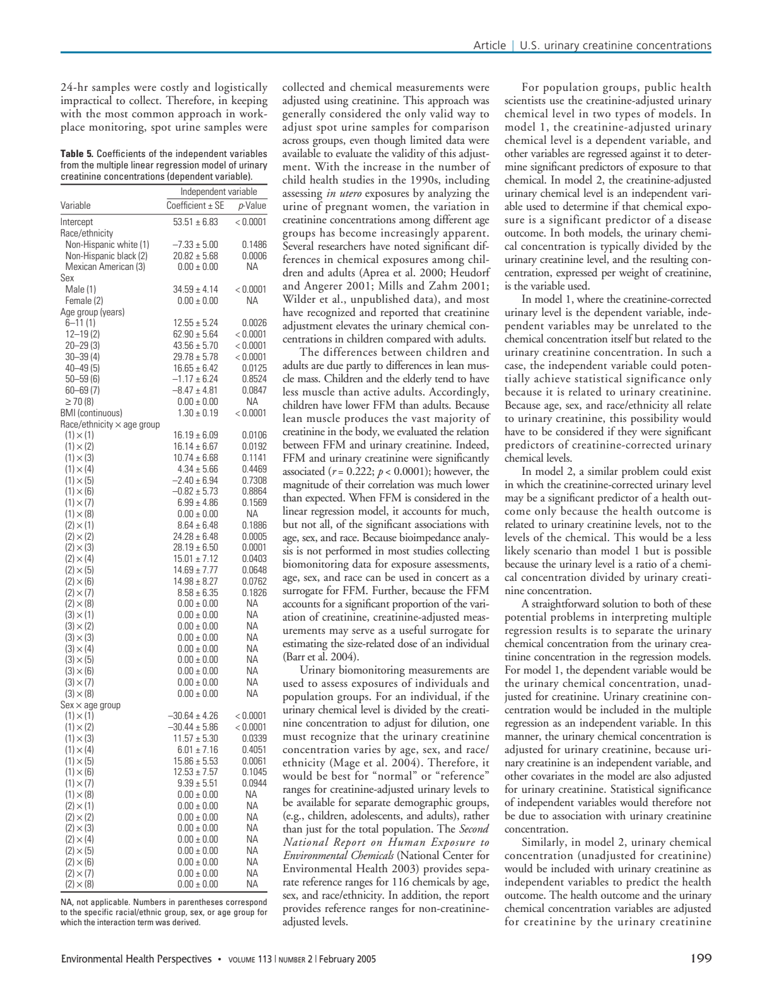

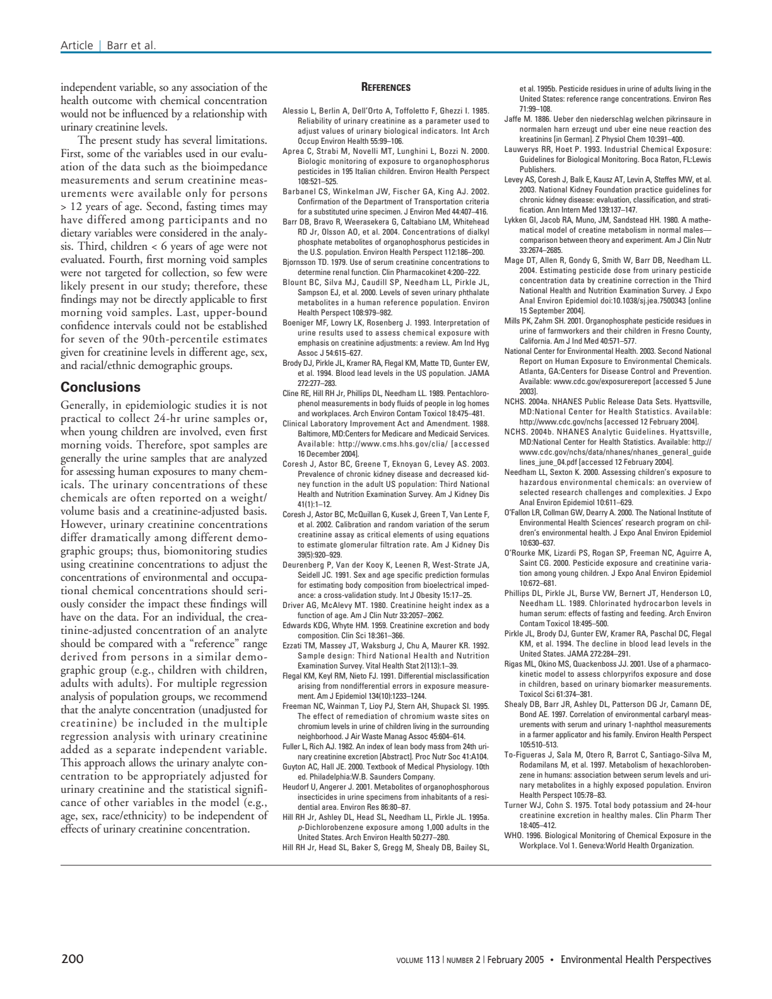

In [18]:
file_dir = '../../../edspdf-train/data/publaynet/train/PMC1277864'
pdf_path, xml_path = get_paths(file_dir = file_dir)
print(f'xml path: {xml_path}\npdf path: {pdf_path}')

pdf = Path(pdf_path).read_bytes()
doc: PDFDoc = model.get_pipe("extractor")(pdf)

for page in show_annotations(doc.content, []):
    display(page)

In [82]:
with open(pk_path, 'rb') as file:
    loaded_pmc_data = pk.load(file)

## Display pdf(show annotation) with the loaded pkl file

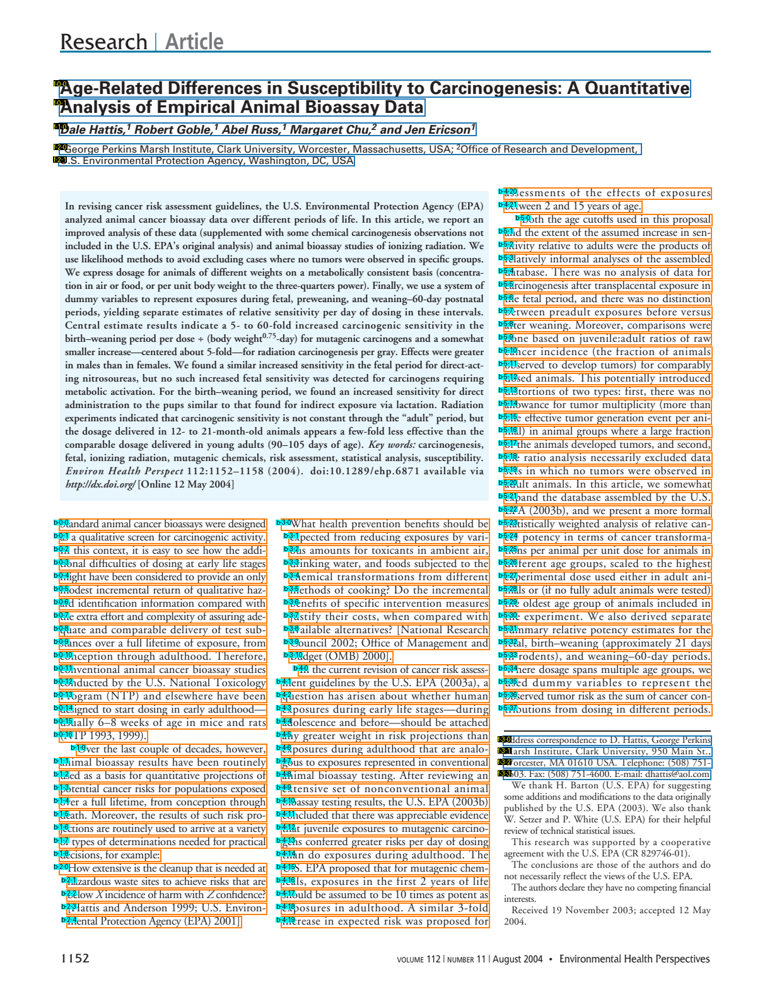

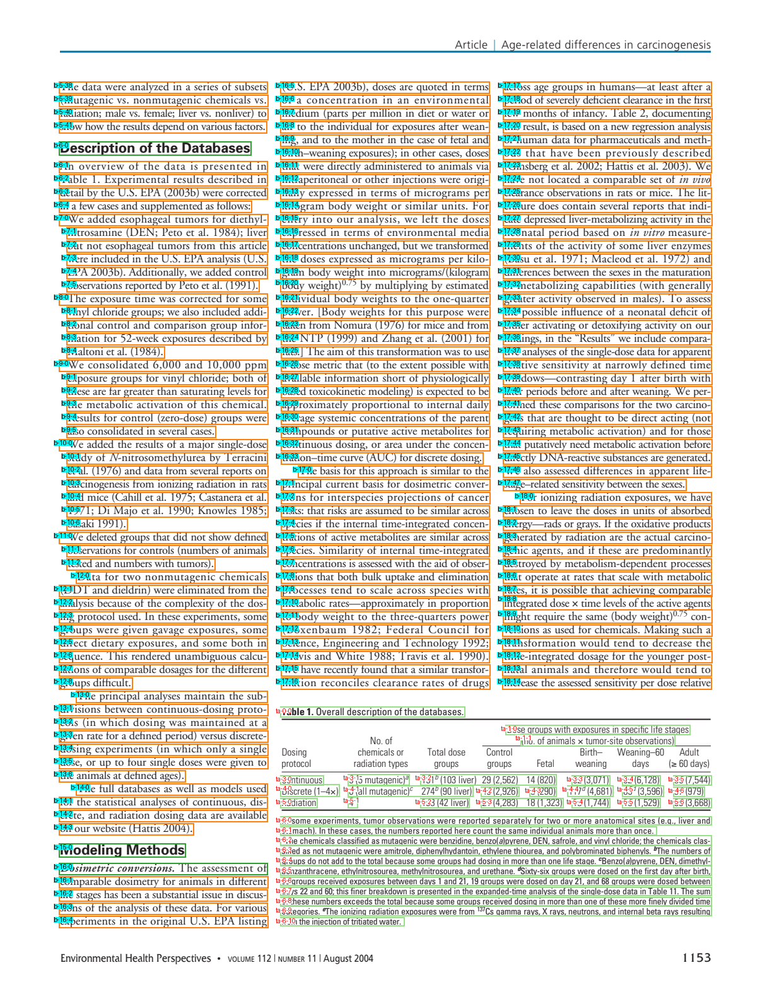

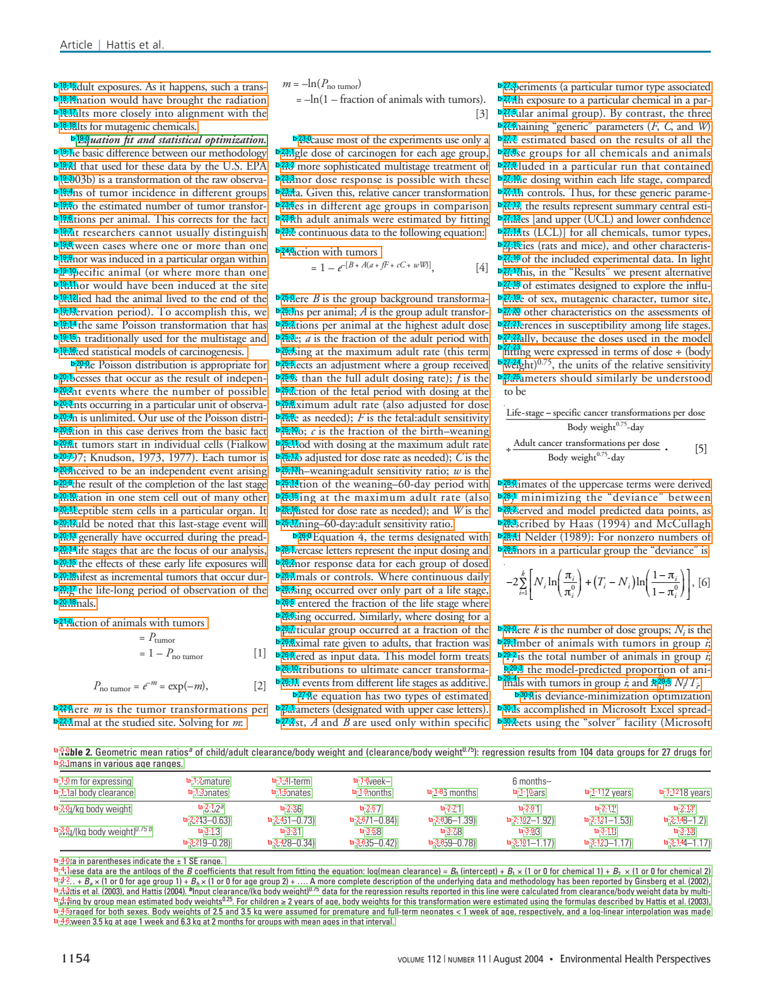

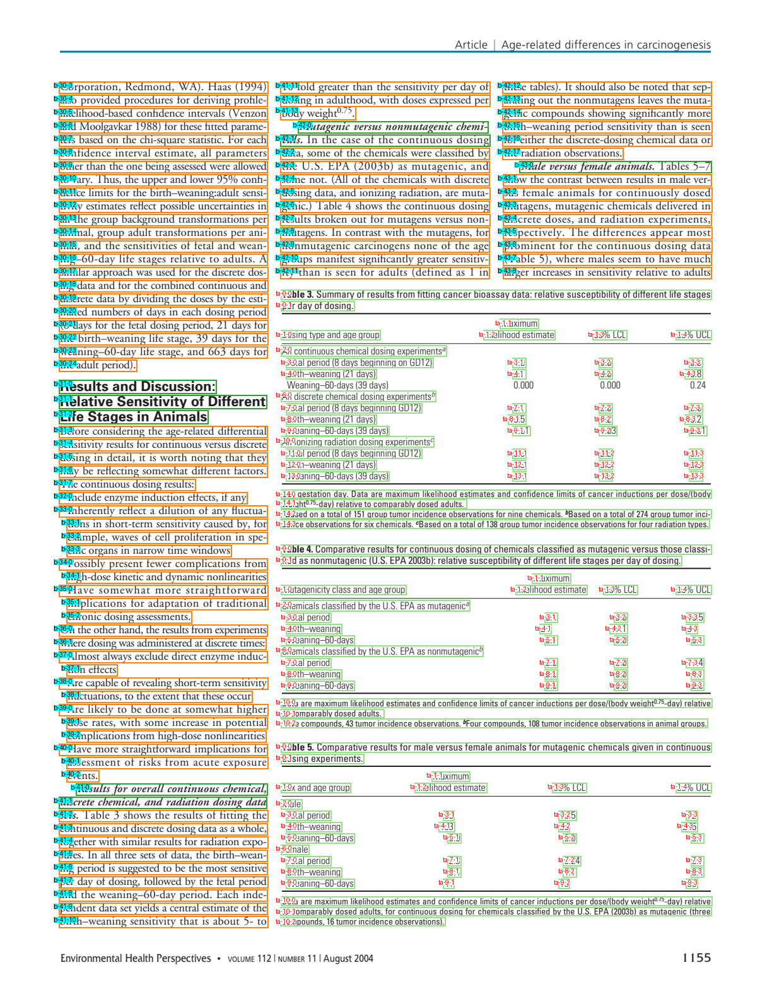

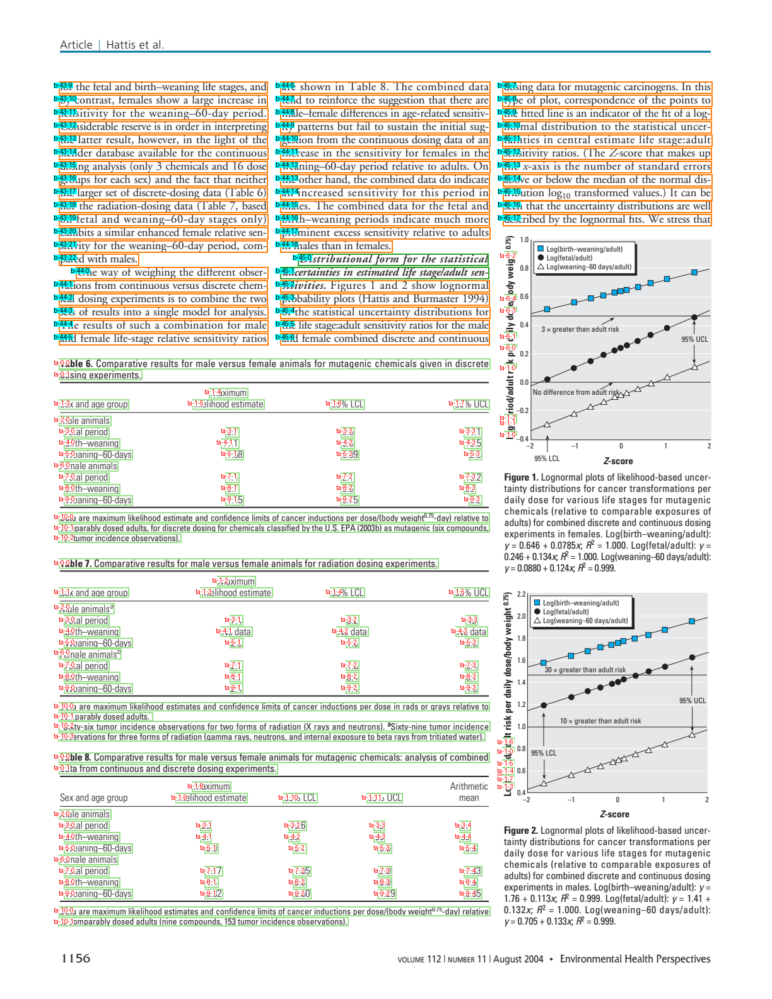

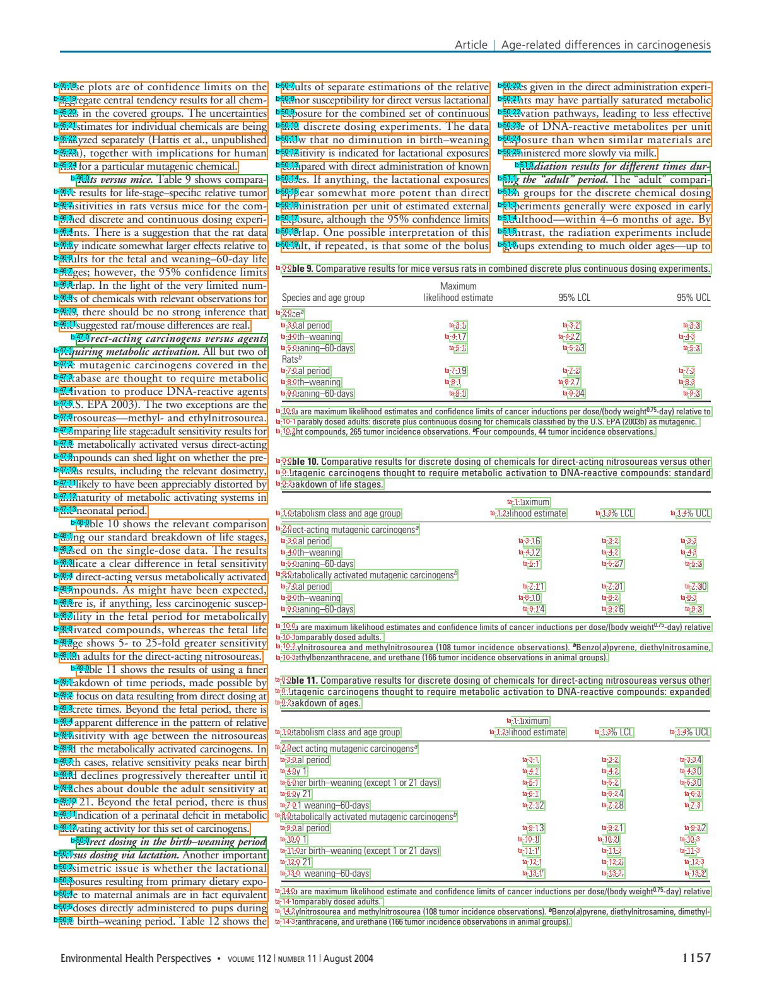

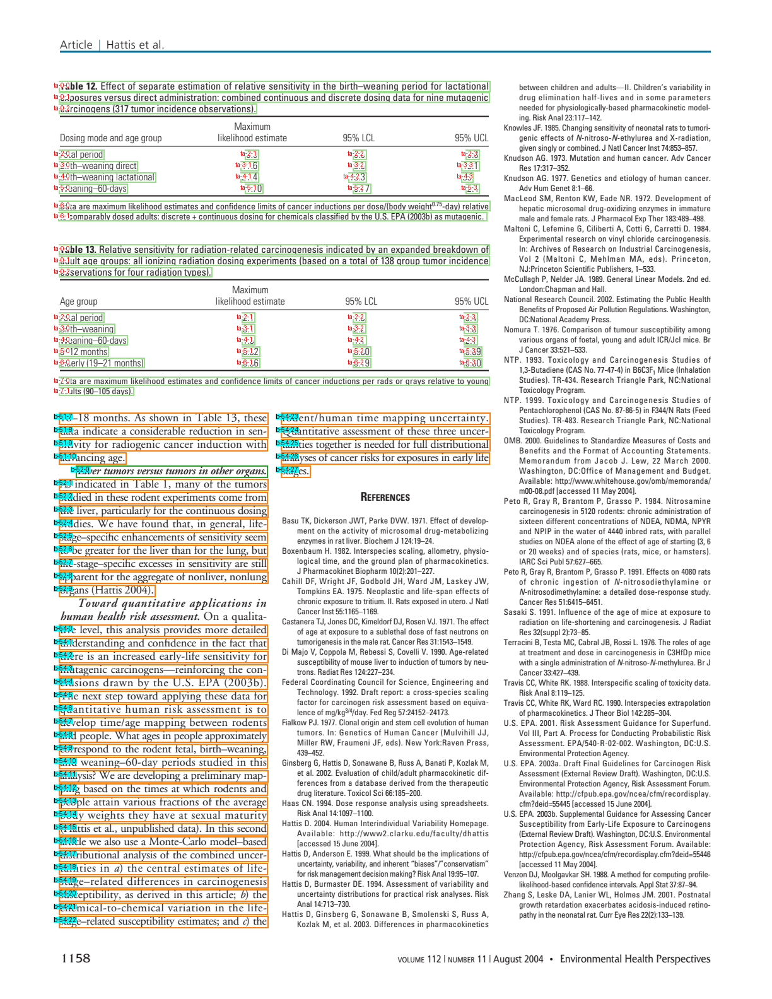

In [11]:
from edspdf.structures import Box, Box_lines, TextBox


# ------------------------
# PMC1087887  -->  1/100
# table 0 nodes 43/43
# table 1 nodes 13/13
# table 2 nodes 9/9
# body nodes 63/71
# front nodes 5/8

xmls_dir = base_dir + 'train/'
pk_path = xmls_dir + 'PMC1247474/pmc_data.pkl'
with open(pk_path, 'rb') as file:
    loaded_pmc_data = pk.load(file)
pdf = Path(loaded_pmc_data['pdf_path']).read_bytes()
doc_2: PDFDoc = model.get_pipe("extractor")(pdf)

content_boxes = []
for li in loaded_pmc_data['front_lines'] + loaded_pmc_data['body_lines'] + loaded_pmc_data['table_lines']:
    _tb = TextBox(
        x0=li['x0'],
        x1=li['x1'],
        y0=li['y0'],
        y1=li['y1'],
        text=li['text'],
        label=li['label'],
        page_num=li['page_num'],
        )
    if li['node_type'] == 'front':
        _tb.rank = f"{li['node_type'][0]}-{li['node_num']}-{li['rank']}"
        _tb.color='yellow'
        _tb.bg_color='black'
    if li['node_type'] == 'body':
        _tb.rank = f"{li['node_type'][0]}-{li['node_num']}-{li['rank']}"
        _tb.color='black'
        _tb.bg_color='cyan'
    if li['node_type'] == 'table':
        _tb.rank = f"{li['node_type'][:2]}-{li['node_num']}-{li['rank']}"
        _tb.color='red'
        _tb.bg_color='white'
    content_boxes.append(_tb)

for page in show_annotations(doc_2.content, content_boxes):
    display(page)

In [7]:
loaded_pmc_data.keys()

dict_keys(['pmc', 'pdf_path', 'xml_path', 'nb_pages', 'front_lines', 'body_lines', 'table_lines', 'not_matched_lines', 'tables_matching_stats', 'nb_body_nodes', 'nb_matched_body_nodes', 'nb_front_nodes', 'nb_matched_front_nodes'])

In [8]:
# Read XML
xml = open(loaded_pmc_data['xml_path'], 'rb')
tree = etree.parse(xml)
# root = tree.getroot()

printXML(tree)

<!DOCTYPE article PUBLIC "-//NLM//DTD Journal Archiving and Interchange DTD v2.3 20070202//EN" "archivearticle.dtd">
<article xmlns:xlink="http://www.w3.org/1999/xlink" article-type="research-article">
  <?properties open_access?>
  <front>
    <journal-meta>
      <journal-id journal-id-type="nlm-ta">Thromb J</journal-id>
      <journal-title>Thrombosis Journal</journal-title>
      <issn pub-type="epub">1477-9560</issn>
      <publisher>
        <publisher-name>BioMed Central</publisher-name>
        <publisher-loc>London</publisher-loc>
      </publisher>
    </journal-meta>
    <article-meta>
      <article-id pub-id-type="pmid">15836797</article-id>
      <article-id pub-id-type="pmc">1087887</article-id>
      <article-id pub-id-type="publisher-id">1477-9560-3-5</article-id>
      <article-id pub-id-type="doi">10.1186/1477-9560-3-5</article-id>
      <article-categories>
        <subj-group subj-group-type="heading">
          <subject>Original Clinical Investigation</subject>
  

In [13]:
loaded_pmc_data['table_lines'][-5:]

[{'x0': 0.3147372549019608,
  'x1': 0.3350470588235294,
  'y0': 0.35857765151515153,
  'y1': 0.3686786616161616,
  'label': 'table',
  'page_num': 6,
  'text': '0.36',
  'props': [{'italic': False,
    'bold': False,
    'begin': 0,
    'end': 4,
    'fontname': 'ANODNN+Univers-CondensedLight'}],
  'node_type': 'table',
  'node_num': 6,
  'rank': 1,
  'bioul': 'I',
  'table_num': 12},
 {'x0': 0.4585307189542484,
  'x1': 0.478840522875817,
  'y0': 0.35857765151515153,
  'y1': 0.3686786616161616,
  'label': 'table',
  'page_num': 6,
  'text': '0.19',
  'props': [{'italic': False,
    'bold': False,
    'begin': 0,
    'end': 4,
    'fontname': 'ANODNN+Univers-CondensedLight'}],
  'node_type': 'table',
  'node_num': 6,
  'rank': 2,
  'bioul': 'I',
  'table_num': 12},
 {'x0': 0.6028692810457515,
  'x1': 0.6231790849673202,
  'y0': 0.35857765151515153,
  'y1': 0.3686786616161616,
  'label': 'table',
  'page_num': 6,
  'text': '0.60',
  'props': [{'italic': False,
    'bold': False,
    'beg